## Table of Contents
---



---

## Only IBD Data

### Libraries
---

In [1]:
# general libraries
import pandas as pd
import numpy as np
import itertools
import scipy.stats as stats
import random
import statistics
import datetime
import re
import json

In [2]:
# data cleaning libraries
from collections import Counter
# !pip install smote-variants
import smote_variants
from imblearn.over_sampling import SMOTE
from sklearn.feature_selection import SelectKBest, mutual_info_classif, chi2
from sklearn.preprocessing import LabelEncoder, OrdinalEncoder, MinMaxScaler, MaxAbsScaler

In [3]:
# ML libraries
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, roc_auc_score, confusion_matrix, classification_report
from sklearn.model_selection import KFold, train_test_split
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier

In [4]:
# Visualization libraries
from matplotlib import pyplot
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [5]:
now = datetime.datetime.now()
print ("Current date and time : ")
print (now.strftime("%Y-%m-%d %H:%M:%S"))

Current date and time : 
2021-06-04 17:26:25


## Data
---

In [6]:
# toggle to hide code
from IPython.display import HTML

HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit" value="Click here to toggle on/off the raw code."></form>''')

In [7]:
# center all images
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
HTML("""
<style>
.output_png {
    display: table-cell;
    text-align: center;
    vertical-align: middle;
}
</style>
""")

### Pull in Data

***ENDSC Data***

In [8]:
# all cases
all_cases = pd.read_excel("../Data/dataset/ENDOSC_1.xls", sheet_name="All cases")
# cleaned cases
cleaned_cases = pd.read_excel("../Data/dataset/ENDOSC_1_2_2.xls", sheet_name="All IBD")
cleaned_cases_og = cleaned_cases
cleaned_cases.head()


,Year,Lab No,Age,Sex,Active inflammation?,Mucosal surface,Crypt architecture,Crypt profiles,Increased lamina propria cellularity?,Mild & superficial increase in lamina propria cellularity?,...,Mucin depletion,Intraepithelial lymphocytes,Subepithelial collagen,Lamina propria granulomas,Submucosal granulomas,Basal histiocytic cells,Confirmed diagnosis,Method of confirmation,Initial pathologists diagnosis,Observing pathologists diagnosis
0,90,8989,52.410959,1,0,0,2,5,1,0,...,0,0,0,0,0,0,UC,Endoscopy,IBD ?UC,Chronic idiopathic IBD - indeterminate
1,92,10640,24.673973,1,1,0,0,7,1,0,...,2,0,0,0,0,0,Crohns,Resection,"IBD indeterminate, active",Chronic idiopathic IBD - highly suggestive of ...
2,92,7489,51.345205,0,1,0,1,7,1,0,...,2,0,0,0,0,0,Crohns,Endoscopy,IBD ?Crohns,Chronic idiopathic IBD - highly suggestive of ...
3,91,8691,48.556164,1,1,0,2,6,1,0,...,0,0,0,0,0,0,UC,Resection,"IBD indeterminate, active",Chronic idiopathic IBD - indeterminate
4,90,14201,39.367123,0,0,0,0,7,0,0,...,0,1,0,0,0,0,Crohns,Endoscopy,"Non-specific inflammation, acute",Normal


### Data Definitions


In [9]:
# IBD_def = pd.read_excel("../Data/Column_Definitions.xlsx", sheet_name="IBD")

In [10]:
# IBD_def[["Data Column", "Definition", "In depth understanding"]]

In [11]:
cleaned_cases = cleaned_cases.drop(['Year', 'Lab No', 'Method of confirmation', 'Initial pathologists diagnosis', 'Observing pathologists diagnosis'],axis=1)

### Data Manipulation

***IBD Stages***: 
Since the stages of UC is determined by the severity of symptoms, the classes are manually added based on symptoms.

Use decision trees to determine 

Perhaps find a doctor who can provide some expertise into the stages? - check if this is possible (we would need multiple people to have statistically significance)

***Data Transformation***
Since the data is already dummy coded, the transformation of it will be required for understanding the outcome after modeling. 

In [12]:
transform_dict = [{"data":["Mucin depletion", "Crypt architecture"], 
                   "definitions":[{
                       0: "Normal",
                       1: "Mild", 
                       2: "Moderate", 
                       3: "Severe"}]},
                  {"data": ["Cryptitis extent", "Crypt abscesses extent"],
                   "definitions": [{
                       0: "None",
                       1: "Little", 
                       2: "Moderate", 
                       3: "Marked"}]},
                  {"data": ["Lamina propria polymorphs"],
                  "definitions": [{
                      0: "Absent", 
                      1: "Focal", 
                      2: "Diffuse"}]},
                  {"data": ["Cryptitis polymorphs", "Crypt abscesses polymorphs"],
                   "definitions": [{
                       0: "None",
                       1: "Few", 
                       2: "Several", 
                       3: "Many"}]},
                  {"data": ["Epithelial changes"], 
                   "definitions": [{
                       0: "Normal",
                       1: "Flattening ",
                       2:  "Degeneration", 
                       3: "Erosion"}]},
                  {"data": ["Mucosal surface"], 
                   "definitions": [{
                       0: "Flat",
                       1: "Irregular", 
                       2: "Villous projections"}]}]

Set Seed for consistency

In [13]:
random.seed(123)

***Crypt architecture*** measures the severity of the deformation of the colon, which will also signify at what severity stage the cases are at. This is the column that will be used for determining cases severities. 

In [14]:
cleaned_cases['Crypt architecture'].unique()

crypt_dict = {0:"normal",
              1:"mild",
              2:"moderate",
              3:"severe"}

cleaned_cases['Severity of Crypt Arch'] = [crypt_dict[x] for x in cleaned_cases['Crypt architecture']]

'Severity of Crypt Arch' + 'diagnoses'

'Severity of Crypt Archdiagnoses'

***convert data to object*** rather than int since these are categorical data.

In [15]:
def change_to_object(df, data_col):
    df[data_col] = df[data_col].astype(object)

run = [change_to_object(cleaned_cases, c) for c in cleaned_cases.columns[3:]]
cleaned_cases['Crypt profiles'] = cleaned_cases['Crypt profiles'].astype('int')
cleaned_cases.dtypes

Age                                                             float64
Sex                                                               int64
Active inflammation?                                              int64
Mucosal surface                                                  object
Crypt architecture                                               object
Crypt profiles                                                    int32
Increased lamina propria cellularity?                            object
Mild & superficial increase in lamina propria cellularity?       object
Increased lymphoid aggregates in lamina propria?                 object
Patchy lamina propria cellularity?                               object
Marked & transmucosal increase in lamina propria cellularity     object
Cryptitis extent                                                 object
Cryptitis polymorphs                                             object
Crypt abscesses extent                                          

### Data Cleaning

***Clean Diagnosis***:
Strip data and Upper Case and ensure spelling of all are correct to prevent any separation of classes which are unnecessary. 

In [16]:
print(cleaned_cases['Confirmed diagnosis'].unique())
cleaned_cases['Confirmed diagnosis'] = [c.strip().upper() for c in cleaned_cases['Confirmed diagnosis']]
print( cleaned_cases['Confirmed diagnosis'].unique())

['UC' 'Crohns' 'Crohns ' 'Uc']
['UC' 'CROHNS']


In [17]:
#cleaned_cases.columns
#cleaned_cases["Method of confirmation"] = [x if x != "Endosocpy" else "Endoscopy" for x in cleaned_cases["Method of confirmation"]]
#cleaned_cases["Method of confirmation"].unique()

In [18]:
#cleaned_cases['Observing pathologists diagnosis'].unique()

In [19]:
#cleaned_cases['Initial pathologists diagnosis'].unique()
#cleaned_cases['Initial pathologists diagnosis'] = [d if d != "IBD ?Crohn's" else "IBD ?Crohns" for d in cleaned_cases['Initial pathologists diagnosis']]
#cleaned_cases['Initial pathologists diagnosis'] = [d if d not in ["Non-specific inflammation,chronic", "Non-specific inflammaton, chronic"] else "Non-specific inflammation, chronic" for d in cleaned_cases['Initial pathologists diagnosis']]
#cleaned_cases['Initial pathologists diagnosis'].sort_values().unique()

In [20]:
#cleaned_cases['Year'].sort_values().unique()

***Missing/Duplicate Data Checks***

There is no duplicates data

In [21]:
print(f'IBD duplicates: {cleaned_cases.duplicated().any()}')

IBD duplicates: True


There are no missing data values

In [22]:
print(f'IBD missing: {cleaned_cases.isnull().values.any()}')

IBD missing: False


### Train Test Split
Cross and coworkers randomly shuffled the dataset and split the first 540 cases as the train set and the lasts 269 cases as the test set.


In [23]:
X = cleaned_cases.drop('Confirmed diagnosis',axis=1)
y = cleaned_cases['Confirmed diagnosis']
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=269, random_state=123)
print(f'Train set has {X_train.shape[0]} rows and test set has {X_test.shape[0]} rows')

Train set has 375 rows and test set has 269 rows


<h2>Class Imbalance</h2>
The minority class of heatlhy was oversampled so that there were equal diseased as unhealthy classes. This is also reflected in graphs below. 

In [24]:
Counter(y_train)

Counter({'UC': 285, 'CROHNS': 90})

In [25]:
#Counter(cleaned_cases['Initial pathologists diagnosis'])

<h3>EDA</h3>

#### Jamie
---

The age is skewed towards the younger generations, and there are outliers of age under 15 and above 85. Since there is no proof that these age groups are errors opposed to only having a low count, they will be left in the data. 

C:\ProgramData\Anaconda\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



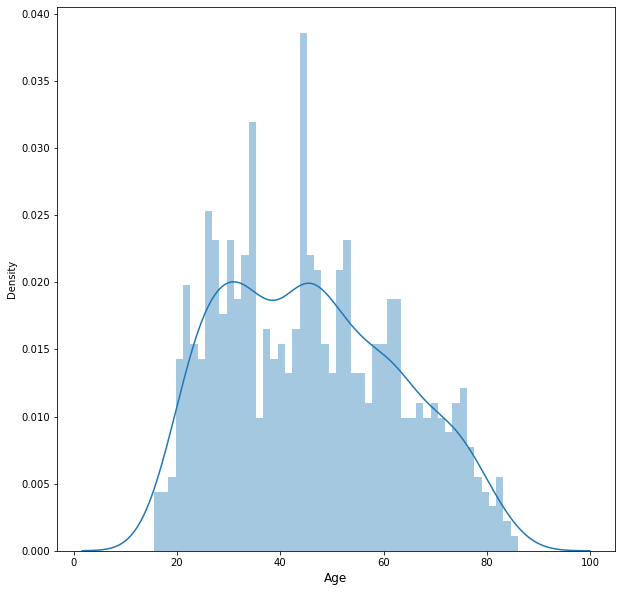

In [26]:
plt.figure(figsize=(10,10))
sns.distplot(cleaned_cases.Age.values, bins=50, kde=True)
plt.xlabel('Age', fontsize=12)
plt.show()

The data below shows that majority of the cases are from years 90-92 and 95-96. The other years have minimal contribution for years prior to year 90. 

In [27]:
#plt.figure(figsize=(10,10))
#sns.distplot(cleaned_cases.Year.values, bins=50, kde=True)
#plt.xlabel('Year', fontsize=12)
#plt.show()

While the data is a mixture of both histology and endoscopy, but majority of the confirmation methods are endoscopy. 

In [28]:
fig = px.histogram(cleaned_cases, x="Age", color='Sex')
fig.show()

Distribution of the dataset, where majority of the classes are UC and the remaining are split to normal and UC roughly evenly. 

In [29]:
cd_gb = cleaned_cases.groupby("Confirmed diagnosis").count().reset_index()
fig = px.bar(cd_gb, x='Confirmed diagnosis', y='Sex')
fig.show()
# cd_gb

In [30]:
fig = px.histogram(cleaned_cases, x="Age", color='Confirmed diagnosis')
fig.show()
plt.figure(figsize=(10,10))

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

### correlations

The correlation matrix is show below, which is no the same method which is used for continuous variable, but rather categorical variables. 

In [31]:
corr_matrix = cleaned_cases.apply(lambda x : pd.factorize(x)[0]).corr(method='pearson', min_periods=1)
corr_matrix.head()

,Age,Sex,Active inflammation?,Mucosal surface,Crypt architecture,Crypt profiles,Increased lamina propria cellularity?,Mild & superficial increase in lamina propria cellularity?,Increased lymphoid aggregates in lamina propria?,Patchy lamina propria cellularity?,...,Lamina propria polymorphs,Epithelial changes,Mucin depletion,Intraepithelial lymphocytes,Subepithelial collagen,Lamina propria granulomas,Submucosal granulomas,Basal histiocytic cells,Confirmed diagnosis,Severity of Crypt Arch
Age,1.000000,-0.024630,0.000645,0.066984,0.024193,-0.013297,0.025116,-0.014794,0.030832,0.030682,...,0.009706,-0.005371,-0.017000,-0.014212,NaN,-0.015907,-0.019861,0.055083,-0.015878,0.024193
Sex,-0.024630,1.000000,0.012179,0.105066,0.000677,0.035672,-0.001894,0.011948,0.010158,-0.012239,...,-0.007131,-0.005653,0.059029,-0.033380,NaN,-0.004193,-0.006338,0.040239,-0.113294,0.000677
Active inflammation?,0.000645,0.012179,1.000000,0.281825,0.066631,0.136076,-0.694303,0.076122,0.320400,0.419807,...,0.900782,0.526095,0.575044,-0.044335,NaN,0.097917,0.018071,0.104854,-0.079975,0.066631
Mucosal surface,0.066984,0.105066,0.281825,1.000000,-0.060980,0.166125,-0.278963,-0.059369,0.025034,-0.067872,...,0.191447,0.228068,0.310093,-0.026130,NaN,-0.051666,-0.040136,0.023768,-0.229855,-0.060980
Crypt architecture,0.024193,0.000677,0.066631,-0.060980,1.000000,0.131529,-0.129055,-0.025416,-0.104277,0.071958,...,0.088256,0.076395,0.107059,-0.004681,NaN,0.038857,0.032759,-0.007064,-0.010103,1.000000


We see strong correlations between the symptoms. Specifically, there is a strong correlation between active inflammation and lamina propria polymorphs, which is investigated further below. 

Many of the correlations are intuitively connected. For example, cryptis polymorphs and extent, since they are both related to the the fact of where there is inflammation in the linings of the stomach to the morphed cells of the glands. 

One interesting obervation is the correlation of epithelial changes and the mucin depletions since the epithelial layer concerns the outter layer of the intestine and the mucin depletion primarily concerns with the inner side of the organ. 

In [32]:
fig = px.imshow(corr_matrix)
fig.update_yaxes(visible=False, showticklabels=False)
fig.update_xaxes(visible=False, showticklabels=False)
fig.show()

***Active inflammation and lamina propria polymorphs***

Overall, the active inflamation makes sense considering if there is no inflammation, that there in turn would have no polymorphs. Since the inner linings are typically only shows to morph when there is inflammation, this is intuitive in the results. 

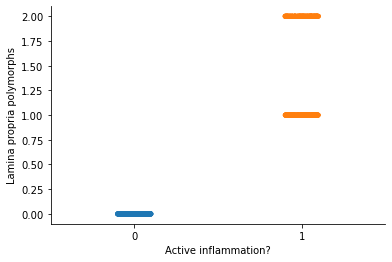

In [33]:
sns.stripplot(x='Active inflammation?', y='Lamina propria polymorphs', data=cleaned_cases, jitter=True)
sns.despine()

Wall time: 1min 36s


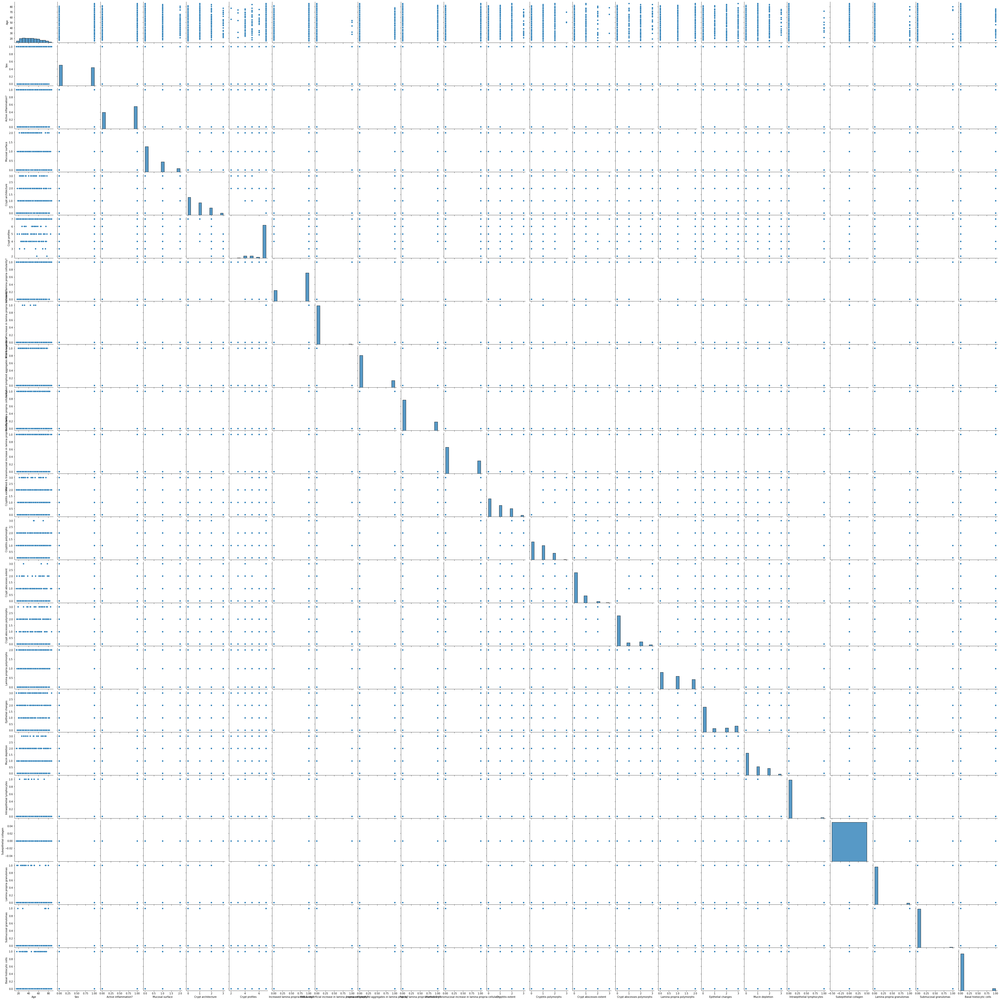

In [34]:
%%time
sns.pairplot(cleaned_cases)

#### Odds Ratio

Odds ratio is a measure of association between an exposure and an outcome. The OR represents the odds that an outcome will occur given a particular exposure, compared to the odds of the outcome occurring in the absence of that exposure. [source](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC2938757/)

There is no strong correlations between the two, that if a patient is of a specified year and age, there is a 1:1 ratio of the patient being diagnosed with UC of chrohns. 

In [36]:
# odds ratio calc
uc_ch = cleaned_cases.loc[cleaned_cases["Confirmed diagnosis"].isin(['UC', 'CROHNS'])]
table_uc = uc_ch[["Confirmed diagnosis", "Sex", "Active inflammation?"]].groupby("Confirmed diagnosis").sum()#.values
print(table_uc)
oddsratio_uc, pvalue_uc = stats.fisher_exact(table_uc)
print("OddsR: ", round(oddsratio_uc,4), "p-Value:", pvalue_uc)

                     Sex  Active inflammation?
Confirmed diagnosis                           
CROHNS                96                    87
UC                   205                   283
OddsR:  1.5233 p-Value: 0.01851111505184613


*** Reducing categorical classes***
Since there isn't a high number of classes in each categorical columns, there is no need to reduce the number of classes in a categorical set. 

#### Walter
---
Each column in the dataset is a symptom.  SOme of the symptoms are rankings.  When the column for Subepithelial collagen is 1 it means that the patient had that symptom and when it is 0 it means the patient did not have that symptom.  

In [37]:
train = pd.concat([X_train,y_train],axis=1)

<h3>Supervised Learning</h3>

Get only the binary variables

In [38]:
binary_vars = X_train.columns[X_train.apply(lambda series: False if set(series)-{0,1} else True)]
binary_vars = list(set(binary_vars) - set(['Active inflammation?']))
# binary_vars

Calculate the relative risk ratio of having IBD if patient has or doesnt have Patchy lamina propria cellularity

In [39]:
patchyVsIbd   = train.groupby(['Patchy lamina propria cellularity?','Confirmed diagnosis']).size()
patchySummary = X_train.groupby('Patchy lamina propria cellularity?').size()
print(patchyVsIbd)
print(patchySummary)

Patchy lamina propria cellularity?  Confirmed diagnosis
0                                   CROHNS                  63
                                    UC                     231
1                                   CROHNS                  27
                                    UC                      54
dtype: int64
Patchy lamina propria cellularity?
0    294
1     81
dtype: int64


What proportion of those with patchy lamina propria had Crohn's Disease?

In [40]:
proportions = patchyVsIbd/patchySummary
proportions

Patchy lamina propria cellularity?  Confirmed diagnosis
0                                   CROHNS                 0.214286
                                    UC                     0.785714
1                                   CROHNS                 0.333333
                                    UC                     0.666667
dtype: float64

How much more chance of getting Crohn's disease if you have patchy lamina propria cellularity VS if you dont have patch lamina prpria cellularity?

In [41]:
proportions.loc[1]/proportions.loc[0]

Confirmed diagnosis
CROHNS    1.555556
UC        0.848485
dtype: float64

Observe above that the probabilit of getting Crohn's is twice as much if you have patchy lamina propria cellularity VS if you dont have patchy lamina.

Determine relative risk of Crohn's or UC for all the symptoms<br>
Calculation will require creating 3 tables:
<ol>
    <li>Symptom, Is Symptom Present, Confirmed Diagnosis, Count</li>
    <li>Symptom, Is Symptom Present, Count</li>
    <li>Symptom, Is Symptom Present, Confirmed Diagnosis, Proportion</li>
    <li>Symptom, Confirmed Diagnosis, Relative Risk (Final Table)</li>
</ol>

In [42]:
#1.Symptom, Is Symptom Present, Confirmed Diagnosis, Count
#Column, Value, Value for Diagnosis Column
binaryTrain = train[binary_vars+['Confirmed diagnosis']]
symptomDiagnosis = binaryTrain.reset_index().melt(id_vars=['index','Confirmed diagnosis'])
#Column, Value, Value for Diagnosis Column, Count
diseaseCountPerSymptom = symptomDiagnosis.groupby(['variable','value','Confirmed diagnosis']).size()
diseaseCountPerSymptom.head()

variable                               value  Confirmed diagnosis
Basal histiocytic cells                0      CROHNS                  86
                                              UC                     269
                                       1      CROHNS                   4
                                              UC                      16
Increased lamina propria cellularity?  0      CROHNS                  36
dtype: int64

In [43]:
#2.Symptom, Is Symptom Present, Count
countPerSymptom = symptomDiagnosis.groupby(['variable','value']).size()
countPerSymptom.head()

variable                                          value
Basal histiocytic cells                           0        355
                                                  1         20
Increased lamina propria cellularity?             0        103
                                                  1        272
Increased lymphoid aggregates in lamina propria?  0        307
dtype: int64

In [44]:
#3. Symptom, Is Symptom Present, Confirmed Diagnosis, Proportion
proportionIbdPerSymptom = diseaseCountPerSymptom/countPerSymptom
proportionIbdPerSymptom.head()

variable                               value  Confirmed diagnosis
Basal histiocytic cells                0      CROHNS                 0.242254
                                              UC                     0.757746
                                       1      CROHNS                 0.200000
                                              UC                     0.800000
Increased lamina propria cellularity?  0      CROHNS                 0.349515
dtype: float64

In [45]:
#4.Symptom, Confirmed Diagnosis, Relative Risk (Final Table)
propDf = proportionIbdPerSymptom.reset_index()
noSymptom  = propDf.loc[propDf['value']==0].drop('value',axis=1).set_index(['variable','Confirmed diagnosis'])
yesSymptom = propDf.loc[propDf['value']==1].drop('value',axis=1).set_index(['variable','Confirmed diagnosis'])

'''
Some symptoms such as Submucosal granulomas are only present in Crohn's pateints. this means there is no 
patient who has both submucosal granuloma and UC.  So the risk of having UC given u have submcuoal granulomas
is 0.  But currently in the yesSymptom df, the row Submucosal granulom and UC does not even exist.  So if that row 
is missing just add a row with 0
'''  
noSymptom = noSymptom.reset_index()
varDxCombos= list(itertools.product(set(noSymptom['variable']),set(noSymptom['Confirmed diagnosis'])))
allCombos  = pd.DataFrame(index=pd.MultiIndex.from_tuples(varDxCombos)) 
allCombos.index.names = ['variable','Confirmed diagnosis']
noSymptom  = noSymptom.set_index(['variable','Confirmed diagnosis'])
yesSymptom = pd.merge(yesSymptom, allCombos, left_index=True, right_index=True, how='outer').fillna({0:0})
yesSymptom.head()

0
variable                                         Confirmed diagnosis          
Basal histiocytic cells                          CROHNS               0.200000
                                                 UC                   0.800000
Increased lamina propria cellularity?            CROHNS               0.198529
                                                 UC                   0.801471
Increased lymphoid aggregates in lamina propria? CROHNS               0.205882

Out of all the people that had Increased lamina propria cellularity, what percent of them had Crohn's disase?<br>
In below table see that 22.5% of patients with Increased lamina propria cellularity had Crohn's disease.

Out of all the people that did NOT have Increase lamina propria cellularity, how many had Crohn's disease?

In [46]:
noSymptom = pd.merge(noSymptom, allCombos, left_index=True, right_index=True, how='outer').fillna({0:0})
noSymptom.head()

0
variable                                         Confirmed diagnosis          
Basal histiocytic cells                          CROHNS               0.242254
                                                 UC                   0.757746
Increased lamina propria cellularity?            CROHNS               0.349515
                                                 UC                   0.650485
Increased lymphoid aggregates in lamina propria? CROHNS               0.247557

You have two people, one with increased lamina propria cellularity and the other one without increased lamina propria cellularity.  How much more likely is the first person to have Crohn's disease compared to the second?

You have two people, one with increased lamina propria cellularity and the other one without increased lamina propria cellularity.  How much more likely is the first person to have Crohn's disease compared to the second?

In [47]:
relativeRiskIbd = (yesSymptom/noSymptom).reset_index()
relativeRiskIbd.head()

,variable,Confirmed diagnosis,0
0,Basal histiocytic cells,CROHNS,0.825581
1,Basal histiocytic cells,UC,1.055762
2,Increased lamina propria cellularity?,CROHNS,0.568015
3,Increased lamina propria cellularity?,UC,1.232112
4,Increased lymphoid aggregates in lamina propria?,CROHNS,0.831656


[Text(0.5, 1.0, 'UC'),
 Text(0.5, 0, 'Relative Risk of Diagnosis Given That Patient has this Symptom')]

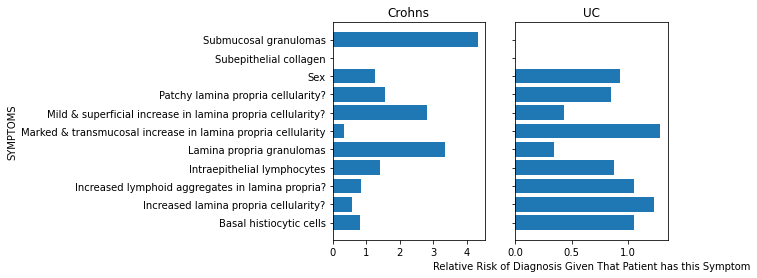

In [48]:
fig,ax = plt.subplots(nrows=1,ncols=2, sharey=True)
crohns = relativeRiskIbd[relativeRiskIbd['Confirmed diagnosis']=='CROHNS']
uc     = relativeRiskIbd[relativeRiskIbd['Confirmed diagnosis']=='UC']
# normal = relativeRiskIbd[relativeRiskIbd['Confirmed diagnosis']=='NORMAL']
ax[0].barh(crohns['variable'],crohns[0])
ax[0].set(title='Crohns',
         ylabel='SYMPTOMS')
ax[1].barh(uc['variable'],uc[0])
ax[1].set(title='UC',xlabel='Relative Risk of Diagnosis Given That Patient has this Symptom',)
#ax[2].barh(normal['variable'],normal[0])
# ax[2].set(title='Normal')

For unsupervised EDA, The objective is to find multiple symptoms that are all 1 for the same patients and are all 0 for other patients.  

<ol>
    <li>First, manually calculate the risk ratio between Symptom A and Symptom B</li>
    <li>Next, create a cross tab where the row is Symptom A, the column is Symptom B and the cell value is the risk ratio of Symptom B / Symptom A</li>
    <li>Finally, find the groups of symptoms that have highest risk ratios for one another.  If 3 columns have high relative risk ratios, consider keeping only one of those columns and dropping the other 2</li>
</ol>

<h4>Risk Ratio</h4>
What is the risk of getting "Increased lamina propria cellularity" if you do have "Lamina propria granulomas" versus the risk of getting "Increased lamina propria cellularity" if you do not have "Lamina propria granulomas"?<br><br>

If two symptoms are both positive in 1000 patients.  And in another 1000 patients the two symptoms are negative.  This would indicate correlation between those 2 symptoms.

In [49]:
exposure = 'Lamina propria granulomas'
disease  = 'Increased lamina propria cellularity?'
risks = X_train.groupby([exposure,disease]
               ).size()/X_train.groupby([exposure]).size()
risks = risks.reset_index()
riskGivenNoExposure = risks.loc[(risks[exposure] == 0)&
                              (risks[disease] == 1),0].values[0]
riskGivenExposure   = risks.loc[(risks[exposure] == 1)&
                              (risks[disease] == 1),0].values[0]
riskGivenExposure/riskGivenNoExposure

1.2046332046332047

Get the cross tab of every symptom with every other symptom

In [50]:
def multicolumn_crosstab(df,cols):
    cols=sorted(cols)
    dummies = pd.get_dummies(df[cols])
    dfWithDummies = pd.concat([df,dummies],axis=1)
    dfWithDummies = dfWithDummies.reset_index()
    dfMelt = dfWithDummies.melt(id_vars=np.concatenate([np.array(['index']),dummies.columns.values]),
                      value_vars=cols)
    dfMelt = dfMelt.drop('index',axis=1)
    levelGroup = dfMelt.groupby(['variable','value'])
    crosstab = levelGroup.sum()
    countPerLevel = levelGroup.size()
    crossTabProp = crosstab.divide(countPerLevel,axis=0)
    return crossTabProp

In [51]:
ct = multicolumn_crosstab(X_train.astype(str),binary_vars)

In the below cross tab, the value in the second row, and in the fourth column (Incerased Lamina propria cellularity_1) is the number 0.894737.  This means that 89% of the patients (in the train set) had both Basal histocytic cells and Increased lamina propria cellularity.  Notice how this number 89% adds up tihe the 10.5263 % on the left of it.  That 10% number is the proportion of patients that had basal histocytic cells but did NOT have icnreased lamina propria cellularity.

In [52]:
ct.head()

Basal histiocytic cells_0  \
variable                                         value                              
Basal histiocytic cells                          0                       1.000000   
                                                 1                       0.000000   
Increased lamina propria cellularity?            0                       0.980583   
                                                 1                       0.933824   
Increased lymphoid aggregates in lamina propria? 0                       0.941368   

                                                        Basal histiocytic cells_1  \
variable                                         value                              
Basal histiocytic cells                          0                       0.000000   
                                                 1                       1.000000   
Increased lamina propria cellularity?            0                       0.019417   
                                                 1                       0.066176   
Increased lymphoid aggregates in lamina propria? 0                       0.058632   

                                                        Increased lamina propria cellularity?_0  \
variable                                         value                                            
Basal histiocytic cells                          0                                     0.284507   
                                                 1                                     0.100000   
Increased lamina propria cellularity?            0                                     1.000000   
                                                 1                                     0.000000   
Increased lymphoid aggregates in lamina propria? 0                                     0.335505   

                                                        Increased lamina propria cellularity?_1  \
variable                                         value                                            
Basal histiocytic cells                          0                                     0.715493   
                                                 1                                     0.900000   
Increased lamina propria cellularity?            0                                     0.000000   
                                                 1                                     1.000000   
Increased lymphoid aggregates in lamina propria? 0                                     0.664495   

                                                        Increased lymphoid aggregates in lamina propria?_0  \
variable                                         value                                                       
Basal histiocytic cells                          0                                               0.814085    
                                                 1                                               0.900000    
Increased lamina propria cellularity?            0                                               1.000000    
                                                 1                                               0.750000    
Increased lymphoid aggregates in lamina propria? 0                                               1.000000    

                                                        Increased lymphoid aggregates in lamina propria?_1  \
variable                                         value                                                       
Basal histiocytic cells                          0                                               0.185915    
                                                 1                                               0.100000    
Increased lamina propria cellularity?            0                                               0.000000    
                                                 1                                               0.250000    
Increased lymphoid aggregates in lamina propr

Which feature is most correlated with the other features? <br><br>
Observe that "Increased lamina propria cellularity" and "Active Inflammation" are the columns that is most correlated with the other symptoms.

noExposureDf: Get all the risks of getting Symptom B given that you dont have symptom A.<br>
exposureDf:   Get all the risks of getting Symptom B given that you do have symptom A.

In [53]:
crossTab     = ct.reset_index()
noExposureDf = crossTab.loc[crossTab['value']=='0']
exposureDf   = crossTab.loc[crossTab['value']=='1']

Divide all the risk-given-exposure/ risk-given-no-exposure to get the relative risk for every symptom pair

In [54]:
noExposureDf = noExposureDf.set_index('variable').drop('value',axis=1)
exposureDf   = exposureDf.set_index('variable').drop('value',axis=1)
relativeRisks= exposureDf/noExposureDf
relativeRisks.head()

,Basal histiocytic cells_0,Basal histiocytic cells_1,Increased lamina propria cellularity?_0,Increased lamina propria cellularity?_1,Increased lymphoid aggregates in lamina propria?_0,Increased lymphoid aggregates in lamina propria?_1,Intraepithelial lymphocytes_0,Intraepithelial lymphocytes_1,Lamina propria granulomas_0,Lamina propria granulomas_1,...,Marked & transmucosal increase in lamina propria cellularity_1,Mild & superficial increase in lamina propria cellularity?_0,Mild & superficial increase in lamina propria cellularity?_1,Patchy lamina propria cellularity?_0,Patchy lamina propria cellularity?_1,Sex_0,Sex_1,Subepithelial collagen_0,Submucosal granulomas_0,Submucosal granulomas_1
variable,,,,,,,,,,,,,,,,,,,,,
Basal histiocytic cells,0.000000,inf,0.351485,1.257874,1.105536,0.537879,1.026012,0.000000,0.934211,2.730769,...,0.910256,1.008523,0.0,0.625000,2.500000,1.431452,0.525148,1.0,1.011396,0.0
Increased lamina propria cellularity?,0.952315,3.408088,0.000000,inf,0.750000,inf,0.993557,1.325368,0.971061,2.461397,...,inf,0.988971,inf,0.702206,inf,1.005214,0.994026,1.0,0.985294,inf
Increased lymphoid aggregates in lamina propria?,1.031040,0.501634,0.000000,1.504902,0.000000,inf,0.993235,1.289916,1.051370,0.000000,...,0.000000,1.009868,0.0,1.281467,0.173643,0.985027,1.017399,1.0,1.013201,0.0
Intraepithelial lymphocytes,1.057803,0.000000,0.805281,1.074214,0.948889,1.232323,0.000000,inf,0.924242,2.904762,...,1.016667,1.008264,0.0,0.991870,1.029536,0.616162,1.452381,1.0,1.011050,0.0
Lamina propria granulomas,0.912281,2.666667,0.475248,1.204633,1.232877,0.000000,0.954545,3.000000,0.000000,inf,...,0.000000,1.008403,0.0,0.164384,4.588235,0.865979,1.156627,1.0,0.802228,72.0


The relative risk from our risk matrix is the same as the one when we manually calculated it. 1.559171

In [55]:
relativeRisks.loc['Lamina propria granulomas','Increased lamina propria cellularity?_1' ]

1.2046332046332047

Replace infinity values or abnormally high Relative risks with 0

In [56]:
relativeRisks = relativeRisks.applymap(lambda cell:0 if cell>20 else cell)

Observe in heatmap below that Submucosal granulomas are highly correlated with lamina propria granulomas

<AxesSubplot:ylabel='variable'>

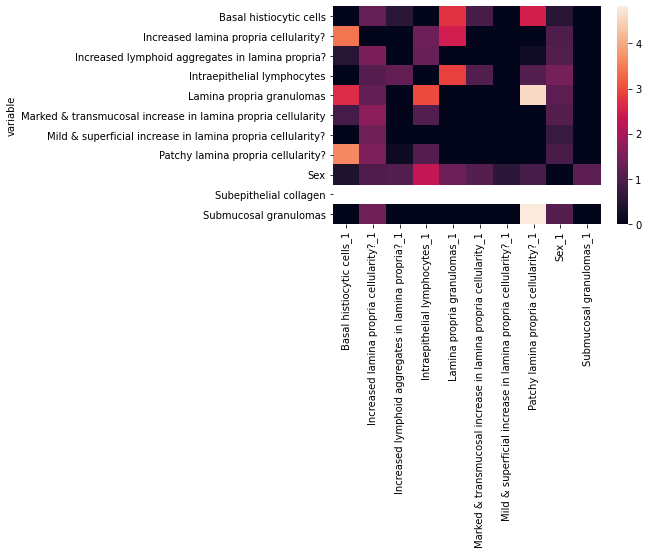

In [57]:
symptomPresent = [column for column in ct.columns if '1' in column]
sns.heatmap(relativeRisks[symptomPresent])

Out of the 453 patients that did not have patchy lamina propria cellularity none of those patients also had lamina propria granulomas.<br>
However, out of the 87 patients that had patchy laminap propria cellularity, 4 of those patients also had lamina propria granulomas.<br>
It looks like these 2 columns are correlated.

In [58]:
X_train.groupby(['Patchy lamina propria cellularity?','Submucosal granulomas']).size()

Patchy lamina propria cellularity?  Submucosal granulomas
0                                   0                        294
1                                   0                         77
                                    1                          4
dtype: int64

Out of the 453 patients that did not have patchy lamina propria cellularity only 1 of those patients also had lamina propria granulomas.<br>
However, out of the 87 patients that had patchy laminap propria cellularity, 12 of those patients also had lamina propria granulomas.<br>
It looks like these 2 columns are correlated.

In [59]:
X_train.groupby(['Patchy lamina propria cellularity?','Lamina propria granulomas']).size()

Patchy lamina propria cellularity?  Lamina propria granulomas
0                                   0                            292
                                    1                              2
1                                   0                             68
                                    1                             13
dtype: int64

You have two people, one with increased lamina propria cellularity and the other one without increased lamina propria cellularity.  How much more likely is the first person to have Crohn's disease compared to the second?

In [60]:
train.groupby(['Submucosal granulomas','Confirmed diagnosis']).size()

Submucosal granulomas  Confirmed diagnosis
0                      CROHNS                  86
                       UC                     285
1                      CROHNS                   4
dtype: int64

### Model Assumptions

The model assumptions for all models are not concerning to the data for visualization. The main requirement is that the data doesn't have a linear correlation between features and that the data is independent, assumed by the unique data points. 

Due to the data primarily being categorical, the modifications/assumptions are difficult to decipher. 

### Data Prep for Modeling

***Dummy coding the Data***

There are two different set methods, dummy coding and ordinal. Before converting to dummy code, the data is first returned to it original form, then dummy coded to understand the effects of feature reduction and whether its required. 

In [61]:
# convert it back to the original setup
df_reset = cleaned_cases.copy()
df_reset_od = cleaned_cases.copy()
df_reset.head()

,Age,Sex,Active inflammation?,Mucosal surface,Crypt architecture,Crypt profiles,Increased lamina propria cellularity?,Mild & superficial increase in lamina propria cellularity?,Increased lymphoid aggregates in lamina propria?,Patchy lamina propria cellularity?,...,Lamina propria polymorphs,Epithelial changes,Mucin depletion,Intraepithelial lymphocytes,Subepithelial collagen,Lamina propria granulomas,Submucosal granulomas,Basal histiocytic cells,Confirmed diagnosis,Severity of Crypt Arch
0,52.410959,1,0,0,2,5,1,0,1,0,...,0,0,0,0,0,0,0,0,UC,moderate
1,24.673973,1,1,0,0,7,1,0,0,0,...,2,0,2,0,0,0,0,0,CROHNS,normal
2,51.345205,0,1,0,1,7,1,0,0,0,...,2,3,2,0,0,0,0,0,CROHNS,mild
3,48.556164,1,1,0,2,6,1,0,0,1,...,1,0,0,0,0,0,0,0,UC,moderate
4,39.367123,0,0,0,0,7,0,0,0,0,...,0,0,0,1,0,0,0,0,CROHNS,normal


In [62]:
transform_dict

[{'data': ['Mucin depletion', 'Crypt architecture'],
  'definitions': [{0: 'Normal', 1: 'Mild', 2: 'Moderate', 3: 'Severe'}]},
 {'data': ['Cryptitis extent', 'Crypt abscesses extent'],
  'definitions': [{0: 'None', 1: 'Little', 2: 'Moderate', 3: 'Marked'}]},
 {'data': ['Lamina propria polymorphs'],
  'definitions': [{0: 'Absent', 1: 'Focal', 2: 'Diffuse'}]},
 {'data': ['Cryptitis polymorphs', 'Crypt abscesses polymorphs'],
  'definitions': [{0: 'None', 1: 'Few', 2: 'Several', 3: 'Many'}]},
 {'data': ['Epithelial changes'],
  'definitions': [{0: 'Normal',
    1: 'Flattening ',
    2: 'Degeneration',
    3: 'Erosion'}]},
 {'data': ['Mucosal surface'],
  'definitions': [{0: 'Flat', 1: 'Irregular', 2: 'Villous projections'}]}]

In [63]:
for val in transform_dict:
    print("============new dictionary===========")
    cols = val['data']
    print(val['definitions'])
    for col in cols:
        try:
            df_reset[col] = [val['definitions'][0][v] for v in df_reset[col]]
        except:
            pass

============new dictionary===========
[{0: 'Normal', 1: 'Mild', 2: 'Moderate', 3: 'Severe'}]
============new dictionary===========
[{0: 'None', 1: 'Little', 2: 'Moderate', 3: 'Marked'}]
============new dictionary===========
[{0: 'Absent', 1: 'Focal', 2: 'Diffuse'}]
============new dictionary===========
[{0: 'None', 1: 'Few', 2: 'Several', 3: 'Many'}]
============new dictionary===========
[{0: 'Normal', 1: 'Flattening ', 2: 'Degeneration', 3: 'Erosion'}]
============new dictionary===========
[{0: 'Flat', 1: 'Irregular', 2: 'Villous projections'}]


In [64]:
# review the data transformation
df_reset[["Cryptitis extent","Cryptitis polymorphs","Crypt abscesses extent","Crypt abscesses polymorphs","Lamina propria polymorphs","Epithelial changes","Mucin depletion"]]

# get dummies
dummied = pd.get_dummies(df_reset[["Cryptitis extent","Cryptitis polymorphs","Crypt abscesses extent","Crypt abscesses polymorphs","Lamina propria polymorphs","Epithelial changes","Mucin depletion","Severity of Crypt Arch"]])
# "Method of confirmation","Initial pathologists diagnosis","Observing pathologists diagnosis", 
df_dummy = pd.merge(dummied, cleaned_cases.drop(["Cryptitis extent","Cryptitis polymorphs","Crypt abscesses extent","Crypt abscesses polymorphs","Lamina propria polymorphs","Epithelial changes","Mucin depletion", "Severity of Crypt Arch"], axis=1), how = "inner", left_index=True, right_index=True)
# "Method of confirmation","Initial pathologists diagnosis","Observing pathologists diagnosis",

In [65]:
df_dummy

,Cryptitis extent_Little,Cryptitis extent_Marked,Cryptitis extent_Moderate,Cryptitis extent_None,Cryptitis polymorphs_Few,Cryptitis polymorphs_Many,Cryptitis polymorphs_None,Cryptitis polymorphs_Several,Crypt abscesses extent_Little,Crypt abscesses extent_Marked,...,Mild & superficial increase in lamina propria cellularity?,Increased lymphoid aggregates in lamina propria?,Patchy lamina propria cellularity?,Marked & transmucosal increase in lamina propria cellularity,Intraepithelial lymphocytes,Subepithelial collagen,Lamina propria granulomas,Submucosal granulomas,Basal histiocytic cells,Confirmed diagnosis
0,0,0,0,1,0,0,1,0,0,0,...,0,1,0,0,0,0,0,0,0,UC
1,0,0,1,0,1,0,0,0,1,0,...,0,0,0,1,0,0,0,0,0,CROHNS
2,0,0,1,0,0,0,0,1,0,0,...,0,0,0,1,0,0,0,0,0,CROHNS
3,0,1,0,0,1,0,0,0,1,0,...,0,0,1,0,0,0,0,0,0,UC
4,0,0,0,1,0,0,1,0,0,0,...,0,0,0,0,1,0,0,0,0,CROHNS
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
639,0,0,1,0,1,0,0,0,0,0,...,0,0,0,1,0,0,0,0,1,UC
640,0,0,1,0,1,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,UC
641,1,0,0,0,1,0,0,0,1,0,...,0,0,0,1,0,0,0,0,0,UC
642,1,0,0,0,1,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,UC


for column "Initial pathologists diagnosis_?IBD ?Infective", there is only one instance of this observation. Due to this we will drop the column as it will error during analysis. 

In [66]:
#df_dummy = df_dummy.drop(["Initial pathologists diagnosis_?IBD ?Infective","Initial pathologists diagnosis_Pouchitis", "Initial pathologists diagnosis_Diversion colitis", "Initial pathologists diagnosis_IBD indeterminate, quiescent"] ,axis=1)

In [67]:
df_type = pd.DataFrame(df_dummy.dtypes)

for x in df_type.loc[df_type[0] == "uint8"].reset_index()['index']:
    df_dummy[x] = df_dummy[x].astype('object')

df_dummy.dtypes

Cryptitis extent_Little                                          object
Cryptitis extent_Marked                                          object
Cryptitis extent_Moderate                                        object
Cryptitis extent_None                                            object
Cryptitis polymorphs_Few                                         object
Cryptitis polymorphs_Many                                        object
Cryptitis polymorphs_None                                        object
Cryptitis polymorphs_Several                                     object
Crypt abscesses extent_Little                                    object
Crypt abscesses extent_Marked                                    object
Crypt abscesses extent_Moderate                                  object
Crypt abscesses extent_None                                      object
Crypt abscesses polymorphs_Few                                   object
Crypt abscesses polymorphs_Many                                 

***Ordinal Data***

Ordinal data is the method of which the data is already set up in. This allows the researchers to put the remaining data types into an ordinal set up for analysis. 

In [68]:
ord_cols = ["Severity of Crypt Arch"]
# "Method of confirmation","Initial pathologists diagnosis","Observing pathologists diagnosis",

In [69]:
for val in ord_cols:
    print(val)
    array_un = df_reset_od[val].unique().tolist()
    df_reset_od[val] = df_reset_od[val].apply(lambda x: array_un.index(x))

Severity of Crypt Arch


In [70]:
df_ordinal = df_reset_od
df_ordinal.head()

,Age,Sex,Active inflammation?,Mucosal surface,Crypt architecture,Crypt profiles,Increased lamina propria cellularity?,Mild & superficial increase in lamina propria cellularity?,Increased lymphoid aggregates in lamina propria?,Patchy lamina propria cellularity?,...,Lamina propria polymorphs,Epithelial changes,Mucin depletion,Intraepithelial lymphocytes,Subepithelial collagen,Lamina propria granulomas,Submucosal granulomas,Basal histiocytic cells,Confirmed diagnosis,Severity of Crypt Arch
0,52.410959,1,0,0,2,5,1,0,1,0,...,0,0,0,0,0,0,0,0,UC,0
1,24.673973,1,1,0,0,7,1,0,0,0,...,2,0,2,0,0,0,0,0,CROHNS,1
2,51.345205,0,1,0,1,7,1,0,0,0,...,2,3,2,0,0,0,0,0,CROHNS,2
3,48.556164,1,1,0,2,6,1,0,0,1,...,1,0,0,0,0,0,0,0,UC,0
4,39.367123,0,0,0,0,7,0,0,0,0,...,0,0,0,1,0,0,0,0,CROHNS,1


Of the two differing methods, one of the two will be selected for analysis. 

### Train/Test Split

In [71]:
#X_ord = df_ordinal.drop(columns=["Observing pathologists diagnosis", "Initial pathologists diagnosis", "Confirmed diagnosis"], axis=1)
X_ord = df_ordinal.drop(columns=["Confirmed diagnosis"], axis=1)
y_ord = df_ordinal['Confirmed diagnosis']

X_train_ord , X_test_ord, y_train_ord, y_test_ord = train_test_split(X_ord, y_ord, test_size=0.25, random_state=42)

In [72]:
X_train_ord[X_train_ord.isna().any(axis=1)]

,Age,Sex,Active inflammation?,Mucosal surface,Crypt architecture,Crypt profiles,Increased lamina propria cellularity?,Mild & superficial increase in lamina propria cellularity?,Increased lymphoid aggregates in lamina propria?,Patchy lamina propria cellularity?,...,Crypt abscesses polymorphs,Lamina propria polymorphs,Epithelial changes,Mucin depletion,Intraepithelial lymphocytes,Subepithelial collagen,Lamina propria granulomas,Submucosal granulomas,Basal histiocytic cells,Severity of Crypt Arch


***Max-Min Transformation***

In [73]:
df_ord_scale = df_reset_od.drop("Confirmed diagnosis", 1)
X_train_ord = X_train_ord.copy().reset_index().drop('index',axis=1)
X_test_ord = X_test_ord.copy().reset_index().drop('index',axis=1)
for val in X_train_ord.columns:
    X_train_ord[val] = X_train_ord[val].astype(int)
    X_test_ord[val] = X_test_ord[val].astype(int)

In [74]:
# Scale only columns that have values greater than 1
to_scale = [col for col in X_train_ord.columns if X_train_ord[col].max() > 1]
mms = MinMaxScaler()
scaled = mms.fit_transform(X_train_ord[to_scale])
scaled = pd.DataFrame(scaled, columns=to_scale)
scaled_test = mms.fit_transform(X_test_ord[to_scale])
scaled_test = pd.DataFrame(scaled_test, columns=to_scale)

# Replace original columns with scaled ones
for col in scaled:
    X_train_ord[col] = scaled[col]
    X_test_ord[col] = scaled_test[col]
    
# df_ord_scale = X_train_ord.merge(df_reset_od["Confirmed diagnosis"], how="inner", left_index=True, right_index=True)

In [75]:
# X_train_ord = X_train_ord.merge(df_reset_od["Confirmed diagnosis"], how="inner", left_index=True, right_index=True)
X_train_ord[X_train_ord.isna().any(axis=1)]

,Age,Sex,Active inflammation?,Mucosal surface,Crypt architecture,Crypt profiles,Increased lamina propria cellularity?,Mild & superficial increase in lamina propria cellularity?,Increased lymphoid aggregates in lamina propria?,Patchy lamina propria cellularity?,...,Crypt abscesses polymorphs,Lamina propria polymorphs,Epithelial changes,Mucin depletion,Intraepithelial lymphocytes,Subepithelial collagen,Lamina propria granulomas,Submucosal granulomas,Basal histiocytic cells,Severity of Crypt Arch


In [76]:
X_test_ord[X_test_ord.isna().any(axis=1)]

,Age,Sex,Active inflammation?,Mucosal surface,Crypt architecture,Crypt profiles,Increased lamina propria cellularity?,Mild & superficial increase in lamina propria cellularity?,Increased lymphoid aggregates in lamina propria?,Patchy lamina propria cellularity?,...,Crypt abscesses polymorphs,Lamina propria polymorphs,Epithelial changes,Mucin depletion,Intraepithelial lymphocytes,Subepithelial collagen,Lamina propria granulomas,Submucosal granulomas,Basal histiocytic cells,Severity of Crypt Arch


***SMOTE***

In [77]:
sm = SMOTE(random_state=123)

In [78]:
X_sm, y_sm = sm.fit_resample(X_train_ord, y_train_ord)

print('MixMax Scaler')
print(f'''Shape of X before SMOTE: {X_ord.shape}
Shape of X after SMOTE: {X_sm.shape}''')

MixMax Scaler
Shape of X before SMOTE: (644, 24)
Shape of X after SMOTE: (706, 24)


In [79]:
print('\nBalance of positive and negative classes (%):')
y_sm.value_counts(normalize=True) * 100


Balance of positive and negative classes (%):


CROHNS    50.0
UC        50.0
Name: Confirmed diagnosis, dtype: float64

In [80]:
# Final Sets
data = [X_sm, X_test_ord, y_sm, y_test_ord]

In [81]:
msm = smote_variants.MSMOTE(proportion=28, random_state = 123)
X_msm, y_msm = msm.sample(X_train_ord.values, y_train_ord.values)
X_msm = pd.DataFrame(columns = X_train_ord.columns, data=X_msm)
y_msm = pd.Series(data = y_msm)
msm2 = smote_variants.MSMOTE(proportion=1, random_state = 123)
X_msm, y_msm = msm2.sample(X_msm.values, y_msm.values)
X_msm = pd.DataFrame(columns = X_train_ord.columns, data=X_msm)
y_msm = pd.Series(data = y_msm)

2021-06-04 17:31:35,375:INFO:MSMOTE: Running sampling via ('MSMOTE', "{'proportion': 28, 'n_neighbors': 5, 'n_jobs': 1, 'random_state': 123}")
2021-06-04 17:31:35,643:INFO:MSMOTE: Running sampling via ('MSMOTE', "{'proportion': 1, 'n_neighbors': 5, 'n_jobs': 1, 'random_state': 123}")


### Feature Importance

Chi-squared is used for determining feature importance. [source](https://machinelearningmastery.com/feature-selection-with-categorical-data/)

In [82]:
fs = SelectKBest(score_func=chi2, k='all')
fs.fit(X_sm.to_numpy() , y_sm.to_numpy() )
X_train_fs = fs.transform(X_sm.to_numpy() )
X_test_fs = fs.transform(X_test_ord.to_numpy())

In [83]:
df_features = pd.DataFrame()
df_features['Features'] = X_test_ord.columns
df_features['Scores'] = np.round(fs.scores_,2)
df_features = df_features.sort_values('Scores', ascending=False)

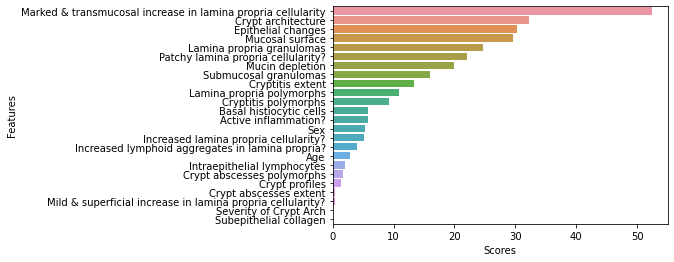

In [84]:
# plot the scores
ax = sns.barplot(x="Scores", y="Features", data=df_features)

In [85]:
# fit the model
# data = [X_sm, X_test_ord, y_sm, y_test_ord]
model = LogisticRegression(solver='lbfgs')
t = model.fit(X_sm, y_sm)
# evaluate the model
yhat = model.predict(X_test_ord)
# evaluate predictions
accuracy = accuracy_score(y_test_ord, yhat)
print('Accuracy: %.2f' % (accuracy*100))

Accuracy: 65.22


In [86]:
assigned = y_sm.unique()
assigned

array(['CROHNS', 'UC'], dtype=object)

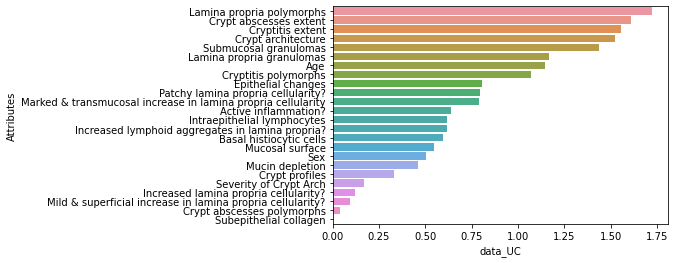

In [87]:
df_logit = pd.DataFrame()
df_logit['Attributes'] = X_sm.columns
for l in range(0, len(model.coef_)):
    df_logit['data_'+str(assigned[1])] = abs(model.coef_[l])
df_logit = df_logit.sort_values(by='data_UC', ascending = False)
# plot the scores
ax = sns.barplot(x="data_UC", y="Attributes", data=df_logit)

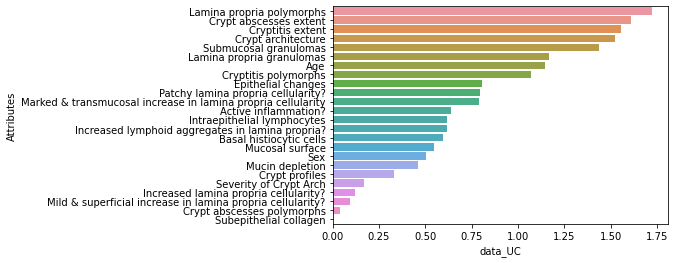

In [88]:
ax = sns.barplot(x="data_UC", y="Attributes", data=df_logit)

In [89]:
# ax = sns.barplot(x="data_NORMAL", y="Attributes", data=df_logit)

### ETL PipeLine

confirmed to not be needed considering time constraint. 

## Machine Learning Models
---

### Parameter Tuning

In [90]:
modelCompare = {'model': [], 'features': [], 'accuracy': [], 'f1': [], 
                'precision': [], 'recall': [], 'params': []}

In [91]:
def hyper_search(modelDictionary, modelParamDictionary, data, features):
    # define empty dictionaries to start
    modelAccuracy = 0
    bestModel = {}
    df_tmp = pd.DataFrame()
    modelCompare = pd.DataFrame()
    features1 = ', '.join(map(str, features))

    # iterate through the model dictionary to execute each model
    for key, value in modelDictionary.items():
        accuracyDics = {}
        finalResults = {}
        print(f'\r\nProcessing Model: {key}')

        # get the hyper parameter dictionary listings for the specific model
        paramDictionary = modelParamDictionary[key]

        # build out all permutations
        keys, values = zip(*paramDictionary.items())
        paramList = [dict(zip(keys, v)) for v in itertools.product(*values)]

        for dic in paramList:
            finalResults = main(value, data, dic)
            accuracyDics.update(groupClassifiers(finalResults))

        bestScore = 0
        avgAccuracy = 0
        plotScore = {}
        for k in accuracyDics:
            for a in accuracyDics[k][0]:
                k1 = {}
                k1 = k[:k.index('(')]
                avgAccuracy = statistics.mean(accuracyDics[k][0]['accuracy'])
                avgF1 = statistics.mean(accuracyDics[k][0]['f1'])
                avgPrecision = statistics.mean(accuracyDics[k][0]['precision'])
                avgRecall = statistics.mean(accuracyDics[k][0]['recall'])
                param = accuracyDics[k][0]['params']
                if avgAccuracy > bestScore:
                    bestScore = avgAccuracy
                    plotScore.clear()
                    plotScore = {'classifier': k1,
                                 'features': features1,
                                 'accuracy': accuracyDics[k][0]['accuracy'],
                                 'avgAccuracy': avgAccuracy,
                                 'f1': accuracyDics[k][0]['f1'],
                                 'avgF1': avgF1,
                                 'precision': accuracyDics[k][0]['precision'],
                                 'avgPrecision': avgPrecision,
                                 'recall': accuracyDics[k][0]['recall'],
                                 'avgRecall': avgRecall,
                                 'params': param}

        #plot_models(plotScore)

        df_tmp = pd.DataFrame({'model': plotScore['classifier'],
                       'features': plotScore['features'],
                       'accuracy': plotScore['avgAccuracy'],
                       'f1': plotScore['avgF1'],
                       'precision': plotScore['avgPrecision'],
                       'recall': plotScore['avgRecall'],
                       'params': plotScore['params']})
        modelCompare = modelCompare.append(df_tmp, ignore_index=True)
        df_tmp = df_tmp[0:0]
        
        print(f'*****************************************************')
        print(f'* {key}')
        print(f'* Best Params Result: ')
        print(f'* {plotScore}')
        print(f'*****************************************************')
        if bestScore > modelAccuracy:
            modelAccuracy = avgAccuracy
            bestModel.clear()
            bestModel = plotScore
    print(f'*****************************************************')
    print(f'* Best Performing Model and Params is:')
    print(f'* {bestModel}')
    print(f'*****************************************************')

    print(f'\r\n{modelCompare}')

In [92]:
def main(clfr, data, clfrHyperParams={}):
    X_, y_, n_folds = data
    kf = KFold(n_splits=n_folds)
    ret = {}

    for id, (trainIndex, testIndex) in enumerate(kf.split(X_, y_)):
        clf = clfr(**clfrHyperParams)
        clf.fit(X_[trainIndex], y_[trainIndex])
        pred = clf.predict(X_[testIndex])
        ret[id] = {'classifier': clf,
                   'accuracy': accuracy_score(y_[testIndex], pred),
                   'f1': f1_score(y_[testIndex], pred, average='weighted'),
                   'precision': precision_score(y_[testIndex], pred, average='micro'),
                   'recall': recall_score(y_[testIndex], pred, average='micro'),
                   'params': clf.get_params(deep=True)}

    #print(classification_report(pred, y_[testIndex]))
    return ret

In [93]:
def groupClassifiers(resultsDict):
    accuraccyDict = {}

    for key in resultsDict:
        c = resultsDict[key]['classifier']
        a = resultsDict[key]['accuracy']
        f = resultsDict[key]['f1']
        p = resultsDict[key]['precision']
        r = resultsDict[key]['recall']
        params = resultsDict[key]['params']
        c_ = str(c).strip()

        # Then check if the string value 'c_' exists as a key in the dictionary
        if c_ in accuraccyDict:
            accuraccyDict[c_][0]['accuracy'].append(a)
            accuraccyDict[c_][0]['f1'].append(f)
            accuraccyDict[c_][0]['precision'].append(p)
            accuraccyDict[c_][0]['recall'].append(r)
        else:
            accuraccyDict[c_] = [{'accuracy': [a], 'f1': [f], 
                                  'precision': [p], 'recall': [r],
                                  'params': [params]}]

    return(accuraccyDict)

In [94]:
def plot_models(accuraccyDict):
    plt.rcParams.update ({'text.usetex': False,
                                 'font.family': 'stixgeneral',
                                 'mathtext.fontset': 'stix'})
    # create a new histogram with a given dictionary key's values
    fig = plt.figure(figsize=(8, 8))
    ax = fig.add_subplot(1, 1, 1)
    plt.hist(accuraccyDict['accuracy'], facecolor='green', alpha=0.75, bins=8)
    plt.text(.20, .5, 'Accuracy Score: ' + str(accuraccyDict['avgAccuracy']) + '\nF1 Score: ' + str(accuraccyDict['avgF1']))
    ax.set_title(accuraccyDict['classifier'], fontsize=15)
    ax.set_xlabel('Classifer Accuracy (By K-Fold)', fontsize=15)
    ax.set_ylabel('Frequency', fontsize=15)
    ax.xaxis.set_ticks(np.arange(0, 1.1, 0.1))
    ax.yaxis.set_ticks(np.arange(0, .5, 1))
    ax.xaxis.set_tick_params(labelsize=15)
    ax.yaxis.set_tick_params(labelsize=15)
    plt.subplots_adjust(left=0.125, right=0.9, bottom=0.1,
                        top=0.6, wspace=0.2, hspace=0.2)
    plt.show()

In [95]:
modelDictionary = {
    'RandomForestClassifier': RandomForestClassifier,
    'KNeighborsClassifier': KNeighborsClassifier,
    'LogisticRegression': LogisticRegression,
    'GaussianNB': GaussianNB,
    'AdaBoostClassifier': AdaBoostClassifier,
    'DecisionTreeClassifier': DecisionTreeClassifier,
    'SVC': SVC,
    'MLPClassifier': MLPClassifier
}

In [96]:
modelParamsDictionary = {
    'RandomForestClassifier': {   # https://sklearn.org/modules/generated/sklearn.ensemble.RandomForestClassifier.html
        'n_estimators': [200, 500, 700],
        'criterion': ['gini', 'entropy'],
        'max_features': ["auto", "sqrt", "log2"],
        'bootstrap': [True],
        'oob_score': [True, False],
        'n_jobs': [-1]
    },
    'KNeighborsClassifier': {  # https://sklearn.org/modules/generated/sklearn.neighbors.KNeighborsClassifier.html
        'n_neighbors': np.arange(12, 18),
        'weights': ['uniform', 'distance'],
        'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
        'n_jobs': [-1]
    },
    'LogisticRegression': {  # https://sklearn.org/modules/generated/sklearn.linear_model.LogisticRegression.html
        'C': [0.0001, 0.001, 1],
        'solver': ['newton-cg', 'lbfgs'],
        'multi_class': ['ovr', 'multinomial'],
        'max_iter': [100, 1000],
        'n_jobs': [-1]
    },
    'GaussianNB': {  # https://sklearn.org/modules/naive_bayes.html#gaussian-naive-bayes
        'var_smoothing': [1e-9]
    },
    'AdaBoostClassifier': {   # https://sklearn.org/modules/generated/sklearn.ensemble.AdaBoostClassifier.html
        'n_estimators': [20, 50, 100, 300],
        'learning_rate': [1]
    },
    'DecisionTreeClassifier': {   # https://sklearn.org/modules/generated/sklearn.tree.DecisionTreeClassifier.html
        'criterion': ['gini', 'entropy'],
        'splitter': ['best', 'random'],
        'max_features': ["auto", "sqrt", "log2"]
    },
    'SVC': {    # https://sklearn.org/modules/generated/sklearn.svm.SVC.html
        'C': [0.0001, 0.001, 1.0],
        'kernel': ['linear'],
        'gamma': ['scale', 'auto'], 
        'cache_size': [4000]
    },
    'MLPClassifier': {    # https://sklearn.org/modules/generated/sklearn.neural_network.MLPClassifier.html
        'activation': ['identity', 'logistic'],
        'solver': ['adam'],
        'learning_rate': ['constant', 'invscaling', 'adaptive'],
        'max_iter': [5000, 7000, 9000]
    }
}

In [103]:
now = datetime.datetime.now()
print ("Current date and time : ")
print (now.strftime("%Y-%m-%d %H:%M:%S"))

Current date and time : 
2021-06-05 09:02:04


In [104]:
n_folds = 5
l = len(df_features['Features']) - 1
df = df_features['Features']

# SMOTE Dataset
X = pd.concat([X_sm, X_test_ord]) #.to_numpy()
y = pd.concat([y_sm, y_test_ord]).to_numpy()
#data = (X, y, n_folds)

print('********************************************')
print('Starting SMOTE data set....')
print('********************************************')

for i in range(l ,6 , -1):
    col = []
    col = df[:i]
    nX = X.loc[:, col]
    nX = nX.to_numpy()
    data = (nX, y, n_folds)
    hyper_search(modelDictionary, modelParamsDictionary, data, col)

********************************************
Starting SMOTE data set....
********************************************

Processing Model: RandomForestClassifier
*****************************************************
* RandomForestClassifier
* Best Params Result: 
* {'classifier': 'RandomForestClassifier', 'features': 'Marked & transmucosal increase in lamina propria cellularity, Crypt architecture, Epithelial changes, Mucosal surface, Lamina propria granulomas, Patchy lamina propria cellularity?, Mucin depletion, Submucosal granulomas, Cryptitis extent, Lamina propria polymorphs, Cryptitis polymorphs, Basal histiocytic cells, Active inflammation?, Sex, Increased lamina propria cellularity?, Increased lymphoid aggregates in lamina propria?, Age, Intraepithelial lymphocytes, Crypt abscesses polymorphs, Crypt profiles, Crypt abscesses extent, Mild & superficial increase in lamina propria cellularity?, Severity of Crypt Arch', 'accuracy': [0.7471264367816092, 0.8045977011494253, 0.7919075144

In [105]:
now = datetime.datetime.now()
print ("Current date and time : ")
print (now.strftime("%Y-%m-%d %H:%M:%S"))

Current date and time : 
2021-06-05 10:17:02


In [106]:
# Original Dataset
X2 = pd.concat([X_train_ord, X_test_ord]) #.to_numpy()
y2 = pd.concat([y_train_ord, y_test_ord]).to_numpy()
#data2 = (X2, y2, n_folds)

print('********************************************')
print('Starting Original data set....')
print('********************************************')

for i in range(l ,6 , -1):
    col = []
    col = df[:i]
    nX2 = X2.loc[:, col]
    nX2 = nX2.to_numpy()
    data2 = (nX2, y2, n_folds)
    hyper_search(modelDictionary, modelParamsDictionary, data2, col)

********************************************
Starting Original data set....
********************************************

Processing Model: RandomForestClassifier
*****************************************************
* RandomForestClassifier
* Best Params Result: 
* {'classifier': 'RandomForestClassifier', 'features': 'Marked & transmucosal increase in lamina propria cellularity, Crypt architecture, Epithelial changes, Mucosal surface, Lamina propria granulomas, Patchy lamina propria cellularity?, Mucin depletion, Submucosal granulomas, Cryptitis extent, Lamina propria polymorphs, Cryptitis polymorphs, Basal histiocytic cells, Active inflammation?, Sex, Increased lamina propria cellularity?, Increased lymphoid aggregates in lamina propria?, Age, Intraepithelial lymphocytes, Crypt abscesses polymorphs, Crypt profiles, Crypt abscesses extent, Mild & superficial increase in lamina propria cellularity?, Severity of Crypt Arch', 'accuracy': [0.7286821705426356, 0.7906976744186046, 0.7674418

In [107]:
now = datetime.datetime.now()
print ("Current date and time : ")
print (now.strftime("%Y-%m-%d %H:%M:%S"))

Current date and time : 
2021-06-05 11:25:12


In [108]:
# MSMOTE Dataset
X3 = pd.concat([X_msm, X_test_ord]) #.to_numpy()
y3 = pd.concat([y_msm, y_test_ord]).to_numpy()
#data = (X, y, n_folds)

print('********************************************')
print('Starting MSMOTE data set....')
print('********************************************')

for i in range(l ,6 , -1):
    col = []
    col = df[:i]
    nX3 = X3.loc[:, col]
    nX3 = nX3.to_numpy()
    data3 = (nX3, y3, n_folds)
    hyper_search(modelDictionary, modelParamsDictionary, data3, col)

********************************************
Starting MSMOTE data set....
********************************************

Processing Model: RandomForestClassifier
*****************************************************
* RandomForestClassifier
* Best Params Result: 
* {'classifier': 'RandomForestClassifier', 'features': 'Marked & transmucosal increase in lamina propria cellularity, Crypt architecture, Epithelial changes, Mucosal surface, Lamina propria granulomas, Patchy lamina propria cellularity?, Mucin depletion, Submucosal granulomas, Cryptitis extent, Lamina propria polymorphs, Cryptitis polymorphs, Basal histiocytic cells, Active inflammation?, Sex, Increased lamina propria cellularity?, Increased lymphoid aggregates in lamina propria?, Age, Intraepithelial lymphocytes, Crypt abscesses polymorphs, Crypt profiles, Crypt abscesses extent, Mild & superficial increase in lamina propria cellularity?, Severity of Crypt Arch', 'accuracy': [0.9748257164988381, 0.9918667699457785, 0.996127033

In [109]:
now = datetime.datetime.now()
print ("Current date and time : ")
print (now.strftime("%Y-%m-%d %H:%M:%S"))

Current date and time : 
2021-06-06 04:16:12


### Creation of novel ML Models

### Running Models

### Results

In [210]:
smotePrintoutBytes = open('smotePrintout_onlyibd.txt','r')
smotePrintout      = smotePrintoutBytes.read()
smotePrintout[:100]

'********************************************\nStarting SMOTE data set....\n***************************'

In [211]:
originalPrintoutBytes = open('originalDatasetPrintout_onlyibd.txt','r')
originalPrintout      = originalPrintoutBytes.read()
originalPrintout[:100]

'********************************************\nStarting Original data set....\n************************'

In [212]:
msmotePrintoutBytes = open('msmotePrintout_onlyibd.txt','r')
msmotePrintout      = msmotePrintoutBytes.read()
msmotePrintout[:100]

'********************************************\nStarting MSMOTE data set....\n**************************'

In [213]:
'''
Using the printout from the SMOTE and original runs,
grab the dictionaries that match this format
{'classifier':'RandomForestClassifier','features':'Feature1, Feature2'}
'''
smoteModelDictionaries = re.findall('Best Params Result: \n\* \{([^}]+)\}',smotePrintout)
originalModelDictionaries = re.findall('Best Params Result: \n\* \{([^}]+)\}',originalPrintout)
msmoteModelDictionaries = re.findall('Best Params Result: \n\* \{([^}]+)\}',msmotePrintout)


In [214]:
'''
each dictionary is in format of 'key':'value' or 'key':[values] or 'key': 0.0002 or 'key': None

get the classifier: (text is here) ..... avgRecall : (text is here) .... avgF1 : (text is here)
'''
def getMetricsForAllModels(modelDictionaries, smote='smote'):
    listOfDicts = []
    for dictionary in modelDictionaries:
        keys   = ['classifier','avgAccuracy','avgF1','avgPrecision','avgRecall']
        values = re.findall("'classifier': '([^']+)'.+'avgAccuracy': ([.\d]+).+'avgF1': ([.\d]+).+'avgPrecision': ([.\d]+).+'avgRecall': ([.\d]+)",dictionary)[0]
        dictionary = dict(zip(keys,values))
        dictionary['smote'] = smote
        listOfDicts.append(dictionary)
    return listOfDicts

In [215]:
smoteDictList    = getMetricsForAllModels(smoteModelDictionaries,'smote')
originalDictList = getMetricsForAllModels(originalModelDictionaries,'no smote')
msmoteDictList    = getMetricsForAllModels(msmoteModelDictionaries,'msmote')

In [216]:
def createModelCompareDf(dictList):
    modelCompare = pd.DataFrame(columns = ['classifier','avgAccuracy','avgF1','avgPrecision','avgRecall'])
    for dictionary in dictList:
        modelCompare = modelCompare.append(dictionary, ignore_index=True)
    return modelCompare

In [217]:
smoteCompareDf = createModelCompareDf(smoteDictList)
originalCompareDf = createModelCompareDf(originalDictList)
msmoteCompareDf = createModelCompareDf(msmoteDictList)
modelCompare    = pd.concat([smoteCompareDf, originalCompareDf,msmoteCompareDf], ignore_index=True)
modelCompare.head()

,classifier,avgAccuracy,avgF1,avgPrecision,avgRecall,smote
0,RandomForestClassifier,0.778552920071756,0.7952724325649522,0.778552920071756,0.778552920071756,smote
1,KNeighborsClassifier,0.7462959271809182,0.77386163218242,0.7462959271809182,0.7462959271809182,smote
2,LogisticRegression,0.648169556840077,0.692048322178302,0.648169556840077,0.648169556840077,smote
3,GaussianNB,0.5866985582353332,0.5370210108736294,0.5866985582353332,0.5866985582353332,smote
4,AdaBoostClassifier,0.7207893163244967,0.7549521900542933,0.7207893163244967,0.7207893163244967,smote
...,...,...,...,...,...,...
403,GaussianNB,0.720112626651713,0.7984659815031586,0.720112626651713,0.720112626651713,msmote
404,AdaBoostClassifier,0.7531899230238491,0.8240891976773125,0.7531899230238491,0.7531899230238491,msmote
405,DecisionTreeClassifier,0.8510259835399666,0.894777159654678,0.8510259835399666,0.8510259835399666,msmote
406,SVC,0.7216604628172689,0.8004168037685991,0.7216604628172689,0.7216604628172689,msmote


In [276]:
modelCompare[['avgAccuracy','avgF1','avgPrecision','avgRecall']] = modelCompare[['avgAccuracy','avgF1','avgPrecision','avgRecall']].astype(float)

In [277]:
bestModels = pd.merge(modelCompare[modelCompare['smote']=='smote'], modelCompare[modelCompare['smote']=='smote'].groupby('classifier')['avgAccuracy'].max().reset_index(), on=['classifier','avgAccuracy'])
bestModelsNo = pd.merge(modelCompare[modelCompare['smote']=='no smote'], modelCompare[modelCompare['smote']=='no smote'].groupby('classifier')['avgAccuracy'].max().reset_index(), on=['classifier','avgAccuracy'])
bestModelsM = pd.merge(modelCompare[modelCompare['smote']=='msmote'], modelCompare[modelCompare['smote']=='msmote'].groupby('classifier')['avgAccuracy','avgF1'].max().reset_index(), on=['classifier','avgAccuracy','avgF1'])


<ipython-input-277-a0afa624f181>:3: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



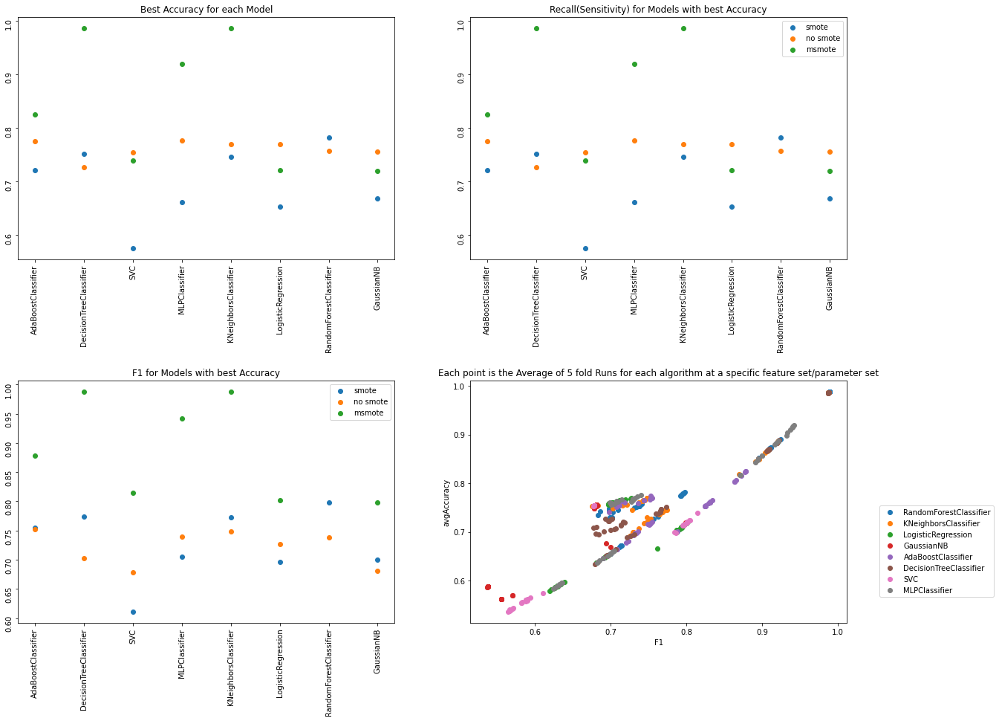

In [278]:
rotation = 90

fig,ax=plt.subplots(nrows=2,ncols=2,figsize=(20,15))
plt.subplots_adjust(hspace=0.5)
ax[0][0].scatter(bestModels['classifier'].unique(),bestModels['avgAccuracy'].unique(),label='smote')
ax[0][0].scatter(bestModelsNo['classifier'].unique(),bestModelsNo['avgAccuracy'].unique(),label='no smote')
ax[0][0].scatter(bestModelsM['classifier'].unique(),bestModelsM['avgAccuracy'].unique(),label='msmote')
ax[0][0].tick_params(rotation=rotation)
ax[0][0].set(title='Best Accuracy for each Model')

ax[0][1].scatter(bestModels['classifier'].unique(),bestModels['avgRecall'].unique(),label='smote')
ax[0][1].scatter(bestModelsNo['classifier'].unique(),bestModelsNo['avgRecall'].unique(),label='no smote')
ax[0][1].scatter(bestModelsM['classifier'].unique(),bestModelsM['avgRecall'].unique(),label='msmote')
ax[0][1].tick_params(rotation=rotation)
ax[0][1].set(title='Recall(Sensitivity) for Models with best Accuracy')
ax[0][1].legend()

ax[1][0].scatter(bestModels['classifier'].unique(),bestModels['avgF1'].unique(),
label='smote')
ax[1][0].scatter(bestModelsNo['classifier'].unique(),bestModelsNo['avgF1'].unique(),label='no smote')
ax[1][0].scatter(bestModelsM['classifier'].unique(),bestModelsM['avgF1'].unique(),label='msmote')
ax[1][0].tick_params(rotation=rotation)
ax[1][0].set(title='F1 for Models with best Accuracy')
ax[1][0].legend()

for classifier in modelCompare['classifier'].unique():
    subdf = modelCompare[modelCompare['classifier']==classifier]
    ax[1][1].scatter(subdf['avgF1'],subdf['avgAccuracy'],label=classifier)
ax[1][1].set(xlabel='F1',ylabel='avgAccuracy',title='Each point is the Average of 5 fold Runs for each algorithm at a specific feature set/parameter set')
ax[1][1].legend(bbox_to_anchor=(1.4,0.5))

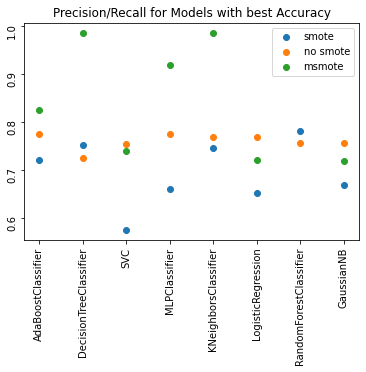

In [279]:
fig,ax=plt.subplots()
ax.scatter(bestModels['classifier'].unique(),bestModels['avgRecall'].unique(),label='smote')
ax.scatter(bestModelsNo['classifier'].unique(),bestModelsNo['avgRecall'].unique(),label='no smote')
ax.scatter(bestModelsM['classifier'].unique(),bestModelsM['avgRecall'].unique(),label='msmote')
ax.tick_params(rotation=90)
ax.set(title='Precision/Recall for Models with best Accuracy')
ax.legend()

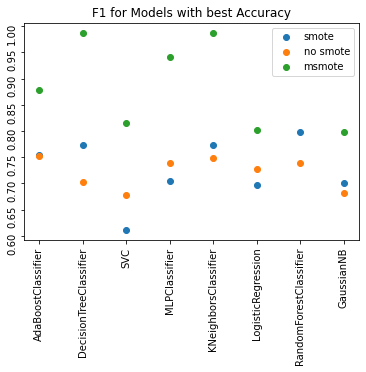

In [280]:
fig,ax=plt.subplots()
ax.scatter(bestModels['classifier'].unique(),bestModels['avgF1'].unique(),label='smote')
ax.scatter(bestModelsNo['classifier'].unique(),bestModelsNo['avgF1'].unique(),label='no smote')
ax.scatter(bestModelsM['classifier'].unique(),bestModelsM['avgF1'].unique(),label='msmote')
ax.tick_params(rotation=90)
ax.set(title='F1 for Models with best Accuracy')
ax.legend()

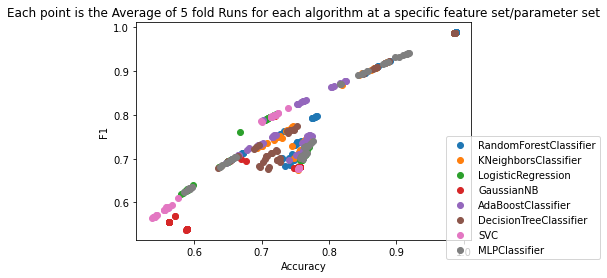

In [281]:
fig,ax=plt.subplots()
for classifier in modelCompare['classifier'].unique():
    subdf = modelCompare[modelCompare['classifier']==classifier]
    ax.scatter(subdf['avgAccuracy'],subdf['avgF1'],label=classifier)
ax.set(xlabel='Accuracy',ylabel='F1',title='Each point is the Average of 5 fold Runs for each algorithm at a specific feature set/parameter set')
ax.legend(bbox_to_anchor=(1.4,0.5))

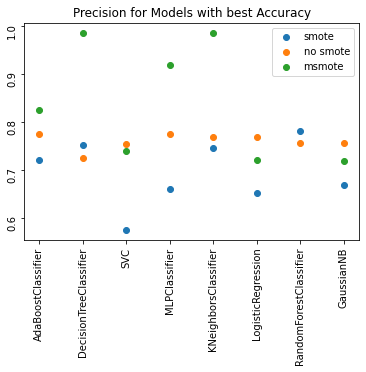

In [282]:
classifiers = list(bestModels['classifier'].unique())
f1s         = list(bestModels['avgPrecision'].astype(float).unique())
classifiers2 = list(bestModelsNo['classifier'].unique())
f1s2         = list(bestModelsNo['avgPrecision'].astype(float).unique())
classifiers3 = list(bestModelsM['classifier'].unique())
f1s3         = list(bestModelsM['avgPrecision'].astype(float).unique())
fig,ax=plt.subplots()
ax.scatter(classifiers,f1s,label='smote')
ax.scatter(classifiers2,f1s2,label='no smote')
ax.scatter(classifiers3,f1s3,label='msmote')
ax.tick_params(rotation=90)
ax.set(title='Precision for Models with best Accuracy')
ax.legend()

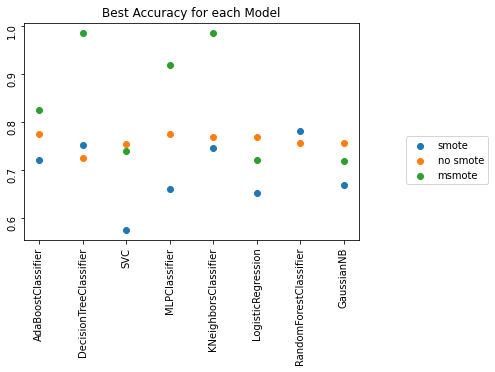

In [283]:
classifiers = list(bestModels['classifier'].unique())
f1s         = list(bestModels['avgAccuracy'].astype(float).unique())
classifiers2 = list(bestModelsNo['classifier'].unique())
f1s2         = list(bestModelsNo['avgAccuracy'].astype(float).unique())
classifiers3 = list(bestModelsM['classifier'].unique())
f1s3         = list(bestModelsM['avgAccuracy'].astype(float).unique())
fig,ax=plt.subplots()
ax.scatter(classifiers,f1s,label='smote')
ax.scatter(classifiers2,f1s2,label='no smote')
ax.scatter(classifiers3,f1s3,label='msmote')
ax.tick_params(rotation=90)
ax.set(title='Best Accuracy for each Model')
ax.legend(bbox_to_anchor=(1.4,0.5))

[Text(0.5, 1.0, 'Best SMOTE vs Best No Smote Models for Random Forest (the best out of all models)')]

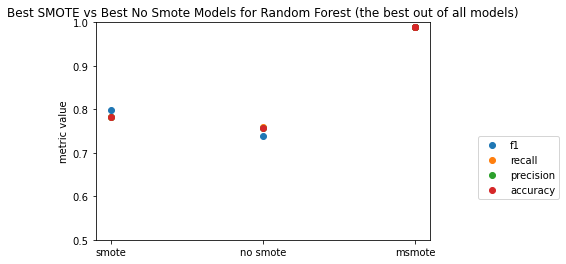

In [293]:
bestRf = pd.merge( modelCompare,
modelCompare[modelCompare['classifier']=='RandomForestClassifier'].groupby(['smote','classifier'])['avgAccuracy'].max().reset_index(),
on = ['classifier','avgAccuracy'])

fig,ax= plt.subplots()

ax.scatter(bestRf['smote_x'],bestRf['avgF1'],label='f1')
ax.scatter(bestRf['smote_x'],bestRf['avgRecall']+0.001,label='recall')
ax.scatter(bestRf['smote_x'],bestRf['avgPrecision'],label='precision')
ax.scatter(bestRf['smote_x'],bestRf['avgAccuracy'],label='accuracy')
ax.set(ylabel='metric value')
ax.legend(bbox_to_anchor=(1.4,0.5))
ax.set(ylim=[0.5,1])
ax.set(title='Best SMOTE vs Best No Smote Models for Random Forest (the best out of all models)')

In [285]:
bestRf

,classifier,avgAccuracy,avgF1,avgPrecision,avgRecall,smote_x,smote_y
0,RandomForestClassifier,0.781981,0.797991,0.781981,0.781981,smote,smote
1,RandomForestClassifier,0.757655,0.738540,0.757655,0.757655,no smote,no smote
2,RandomForestClassifier,0.988380,0.989054,0.988380,0.988380,msmote,msmote
3,RandomForestClassifier,0.988380,0.989047,0.988380,0.988380,msmote,msmote


In [286]:
'''

acc          
recall
f1
precision

'''

'\n\nacc          \nrecall\nf1\nprecision\n\n'

[(0.7, 0.9)]

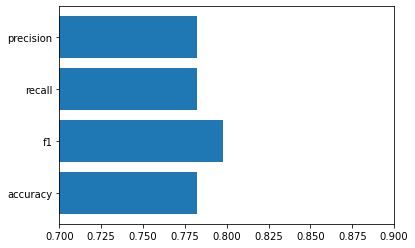

In [299]:
fig,ax=plt.subplots()
ax.barh(['accuracy','f1','recall','precision'],
        [0.781981, 0.797991, 0.781981, 0.781981], label='smote')
ax.set(xlim=[0.7,0.9])

[(0.7, 0.9)]

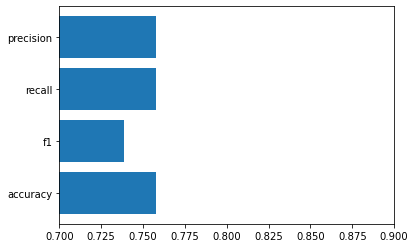

In [302]:
fig,ax= plt.subplots()
ax.barh(['accuracy','f1','recall','precision'],
        [0.757655, 0.738540, 0.757655, 0.757655], label='no smote')
ax.set(xlim=[0.7, 0.9])

[(0.7, 0.9)]

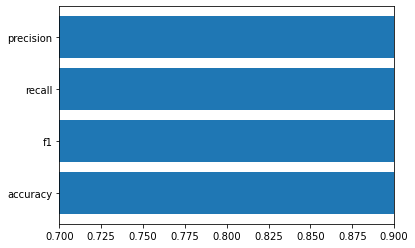

In [303]:
fig,ax= plt.subplots()
ax.barh(['accuracy','f1','recall','precision'],
        [0.988380, 0.989054, 0.988380, 0.988380], label='msmote')
ax.set(xlim=[0.7, 0.9])

### Statistics

### Visualizations

### Discussion

### Conclusions